In [ ]:
!pip install scikit-optimize

In [ ]:
import pandas as pd
from lightgbm import LGBMRegressor
import lightgbm
from sklearn.metrics import mean_absolute_percentage_error
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from datetime import datetime, timedelta
from dateutil.relativedelta import relativedelta
import holidays
from skopt import BayesSearchCV

#Data Selection

In [ ]:
# Import

from google.colab import drive
drive.mount('/content/drive')

dftrain = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Kaggle Time Series Competition/train.csv')
dftest_raw = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Kaggle Time Series Competition/test.csv')
dfsubmission = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Kaggle Time Series Competition/sample_submission.csv')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#Preprocessing

In [ ]:
df =dftrain.copy()
dftest = dftest_raw.copy()

In [ ]:
#Convert variable to date
df['date'] = pd.to_datetime(df['date'])
dftest['date'] = pd.to_datetime(dftest['date'])

#Converts categorical variables
df[['country','store','product']] = df[['country','store','product']].astype('category')
dftest[['country','store','product']] = dftest[['country','store','product']].astype('category')

#Data Analysis Power BI

In [ ]:
!pip install powerbiclient

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()

In [ ]:
from powerbiclient import QuickVisualize, get_dataset_config, Report
from powerbiclient.authentication import DeviceCodeLoginAuthentication
from powerbiclient.authentication import DeviceCodeLoginAuthentication


In [ ]:
device_auth = DeviceCodeLoginAuthentication()

In [ ]:
PBI_visualize = QuickVisualize(get_dataset_config(df), auth=device_auth)

In [ ]:
def loaded_callback(event_details):
    print('Quick visualize has loaded')

PBI_visualize.on('loaded', loaded_callback)

def rendered_callback(event_details):
    print('Quick visualize has rendered')

PBI_visualize.on('rendered', rendered_callback)

def saved_callback(event_details):
    print('Quick visualize has saved the report')

PBI_visualize.on('saved', saved_callback)

In [ ]:
PBI_visualize

QuickVisualize()

Quick visualize has loaded
Quick visualize has rendered


#Data Transformation

In [ ]:
# Function to check if the date is a holiday for a specific country
def is_holiday_in_country(date, country):
    if country == 'Argentina':
        return date in argentina_holidays
    elif country == 'Canada':
        return date in canada_holidays
    elif country == 'Estonia':
        return date in estonia_holidays
    elif country == 'Japan':
        return date in japan_holidays
    else:
        return False

In [ ]:
# Criating new Feature about Date
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['day'] = df['date'].dt.day
df['week_of_year'] = df['date'].dt.isocalendar().week.astype('int64')
df['day_of_week'] = df['date'].dt.dayofweek
df['is_month_end'] = df['date'].dt.is_month_end
df['is_month_start'] = df['date'].dt.is_month_start
df['is_quarter_end'] = df['date'].dt.is_quarter_end
df['is_quarter_start'] = df['date'].dt.is_quarter_start
df['is_year_end'] = df['date'].dt.is_year_end
df['is_year_start'] = df['date'].dt.is_year_start

# Add holidays
# Find unique years in the dataset
unique_years = df['date'].dt.year.unique()

# Create separate arrays for each country with holiday dates for each unique year
argentina_holidays = []
canada_holidays = []
estonia_holidays = []
japan_holidays = []

argentina_holidays.extend(holidays.AR(years=unique_years))
canada_holidays.extend(holidays.CA(years=unique_years))
estonia_holidays.extend(holidays.EE(years=unique_years))
japan_holidays.extend(holidays.JP(years=unique_years))

# Add a new 'holiday' column for each country
for country in df['country'].unique():
    df[f'holiday_{country}'] = df.apply(lambda row: 1 if is_holiday_in_country(row['date'], country) else 0, axis=1)
    dftest[f'holiday_{country}'] = dftest.apply(lambda row: 1 if is_holiday_in_country(row['date'], country) else 0, axis=1)

dftest['year'] = dftest['date'].dt.year
dftest['month'] = dftest['date'].dt.month
dftest['day'] = dftest['date'].dt.day
dftest['week_of_year'] = dftest['date'].dt.isocalendar().week.astype('int64')
dftest['day_of_week'] = dftest['date'].dt.dayofweek
dftest['is_month_end'] = df['date'].dt.is_month_end
dftest['is_month_start'] = df['date'].dt.is_month_start
dftest['is_quarter_end'] = df['date'].dt.is_quarter_end
dftest['is_quarter_start'] = df['date'].dt.is_quarter_start
dftest['is_year_end'] = df['date'].dt.is_year_end
dftest['is_year_start'] = df['date'].dt.is_year_start



<ipython-input-44-a00e25567cee>:4: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior. In a future version these will be considered non-comparable. Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  return date in argentina_holidays
<ipython-input-44-a00e25567cee>:4: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior. In a future version these will be considered non-comparable. Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  return date in argentina_holidays
<ipython-input-44-a00e25567cee>:6: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior. In a future version these will be considered non-comparable. Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  return date in canada_holidays
<ipython-input-44-a00e25567cee>:6: FutureWarning: Compa

In [ ]:
# Column identifying the time difference in days between the most recent purchase and the current purchase

df['time_distance'] = ((df['date'].max() - df['date'])).apply(lambda x: x.days).astype(int)
df.head()

# Column identifying the time difference in days between the most recent purchase and the current purchase
dftest['time_distance'] = ((dftest['date'].max() - dftest['date'])).apply(lambda x: x.days).astype(int)


In [ ]:
##Lambda to return the value of the past date
find_num_sold = lambda x,day: df[(df['date'] == (x['date'] - pd.Timedelta(days=day))) & (df['product'] == x['product'])& (df['country'] == x['country'])& (df['store'] == x['store'])]['num_sold'].values[0]

def find_num_sold2(x):
    result = df.loc[
        (df['date'] == x['date_last_year']) &
        (df['product'] == x['product']) &
        (df['country'] == x['country']) &
        (df['store'] == x['store']), 'num_sold'
    ]
    return result.values[0] if len(result) > 0 else np.nan

##Function that returns day of the week from the previous year
def find_previous_year_same_weekday(date):
    current_date = date
    current_weekday = current_date.weekday()
    previous_year_date = current_date - relativedelta(years=1)

    # Adjust to the last valid day of the month if needed
    while previous_year_date.weekday() != current_weekday:
        previous_year_date -= timedelta(days=1)

    return previous_year_date.strftime('%Y-%m-%d')

In [ ]:
#Create variable day of the week previous year
df['date_last_year'] = df['date'].apply(lambda x: find_previous_year_same_weekday(x))
dftest['date_last_year'] = dftest['date'].apply(lambda x: find_previous_year_same_weekday(x))

In [ ]:
# Cyclic time transformations

# day_of_week
df['day_of_week_sin'] = df['day_of_week'].apply(lambda x: np.sin(x*(2.*np.pi/7)))
df['day_of_week_cos'] = df['day_of_week'].apply(lambda x: np.cos(x*(2.*np.pi/7)))

# month
df['month_sin'] = df['month'].apply(lambda x: np.sin(x*(2.*np.pi/12)))
df['month_cos'] = df['month'].apply(lambda x: np.cos(x*(2.*np.pi/12)))

# day
df['day_sin'] = df['day'].apply(lambda x: np.sin(x*(2.*np.pi/30)))
df['day_cos'] = df['day'].apply(lambda x: np.cos(x*(2.*np.pi/30)))

# week_of_year
df['week_of_year_sin'] = df['week_of_year'].apply(lambda x: np.sin(x*(2.*np.pi/52)))
df['week_of_year_cos'] = df['week_of_year'].apply(lambda x: np.cos(x*(2.*np.pi/52)))

# teste
# day_of_week
dftest['day_of_week_sin'] = dftest['day_of_week'].apply(lambda x: np.sin(x*(2.*np.pi/7)))
dftest['day_of_week_cos'] = dftest['day_of_week'].apply(lambda x: np.cos(x*(2.*np.pi/7)))

# month
dftest['month_sin'] = dftest['month'].apply(lambda x: np.sin(x*(2.*np.pi/12)))
dftest['month_cos'] = dftest['month'].apply(lambda x: np.cos(x*(2.*np.pi/12)))

# day
dftest['day_sin'] = dftest['day'].apply(lambda x: np.sin(x*(2.*np.pi/30)))
dftest['day_cos'] = dftest['day'].apply(lambda x: np.cos(x*(2.*np.pi/30)))

# week_of_year
dftest['week_of_year_sin'] = dftest['week_of_year'].apply(lambda x: np.sin(x*(2.*np.pi/52)))
dftest['week_of_year_cos'] = dftest['week_of_year'].apply(lambda x: np.cos(x*(2.*np.pi/52)))


In [ ]:
##Add Features of the sale of the day in previous years
for day in list(np.arange(start=365, stop=731, step=365)):
    df['venda_produto_lag{}'.format(day)] = df.groupby(['country','store','product','date'],observed=True)['num_sold'].transform(np.sum)
    df['venda_produto_lag{}'.format(day)] = df.groupby(['country','store','product'],observed=True)['venda_produto_lag{}'.format(day)].transform('shift',day).round()
    print(day)

    dftest['venda_produto_lag{}'.format(day)] = dftest.apply(lambda dftest_aux: find_num_sold(dftest_aux,day), axis=1)

##Add Features of the sale of the day in the previous year of the day of the week
df['venda_produto_dia_semana_ano_anterior'] = df.apply(find_num_sold2, axis=1)
dftest['venda_produto_dia_semana_ano_anterior'] = dftest.apply(find_num_sold2, axis=1)


365
730


In [ ]:

#feautures =['country','store','product','year',
#       'month', 'day', 'week_of_year', 'day_of_week', 'is_month_end',
#       'is_month_start', 'is_quarter_end', 'is_quarter_start', 'is_year_end',
#       'is_year_start', 'day_of_week_sin','time_distance', 'venda_produto_lag365',##'venda_produto_dia_semana_ano_anterior',
#       'day_of_week_cos', 'day_sin', 'day_cos',
#       'week_of_year_sin', 'week_of_year_cos',
#        'holiday_Argentina', 'holiday_Canada', 'holiday_Estonia', 'holiday_Japan', 'holiday_Spain'
#     ]

feautures =['venda_produto_lag365',
          'product',
          'country',
          'store',
          'time_distance',
          'year',
          'day',
          'day_sin',
          'day_cos',
          'week_of_year'
          'day_of_week'
          'week_of_year_cos',
          'week_of_year_sin',
          'day_of_week_sin',
          'month',
          'day_of_week_cos']

As we saw on the EDA above, the year 2020 has irregular pattern of sales, probably coming from the covid period, so i will discard it

In [ ]:

df = df[df['year'] != 2020]
x_train = df[feautures]
y_train = df[['num_sold']]

x_test = dftest[feautures]

#Data Mining




In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import TimeSeriesSplit

In [ ]:
clf = lightgbm.LGBMRegressor(learning_rate=0.2,max_depth=50,num_leaves=50,categorical_features = ['product','country', 'store'])

In [ ]:
## Bayes Search
param_bayes = {
    'learning_rate' :[0.01,0.02],
    'num_leaves': [1500,2000,2500,3000,3500],
    'colsample_bytree':[0.85],
    'boosting_type':['gbdt'],
    'max_depth':[15],
    'n_estimators':[450,800,1200],
    'feature_fraction': [0.2,0.3,0.4,0.5],
    'min_child_samples': [14,15,16],
}

# Cross-validation time series split
tscv = TimeSeriesSplit(n_splits=5)

# Tuning using Bayes Search:
bayes_search_model = BayesSearchCV(estimator = clf,
                           search_spaces = param_bayes,
                           scoring = 'neg_mean_absolute_error',#neg_mean_absolute_error#neg_root_mean_squared_error
                           cv=tscv,
                           n_iter = 10,
                           n_jobs = -1,
                           verbose = 2,
                           random_state = 42)

# Training the tuned model with Bayes Search
bayes_search_model.fit(x_train, y_train.values.ravel())

In [ ]:
bayes_search_model.best_params_

In [ ]:
## Seta Hyperparameters
v_learning_rate = 0.023
v_feature_fraction = 0.4
v_min_child_samples = 14
v_max_depth = 15
v_num_leaves = 3000
v_n_estimators = 486
v_boosting_type = 'gbdt'
v_colsample_bytree = 0.85

In [ ]:
## Create and train the model
model = lightgbm.LGBMRegressor(learning_rate=v_learning_rate,max_depth=v_max_depth,num_leaves=v_num_leaves,boosting_type=v_boosting_type,feature_fraction=v_feature_fraction,
                                n_estimators=v_n_estimators,colsample_bytree=v_colsample_bytree,min_child_samples=v_min_child_samples,categorical_features = ['product','country', 'store'],
                               objective='mape',importance_type ='gain')#gain#split

model.fit(x_train, y_train.values.ravel())

In [ ]:
## Make the prediction
y_test = model.predict(x_test)

[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=0.85 will be ignored. Current value: feature_fraction=0.4


In [ ]:
y_test

array([ 38.82768563,  39.60520771,   5.2069318 , ..., 111.39434521,
       573.74204774, 477.06353692])

# Analise Feauture importance

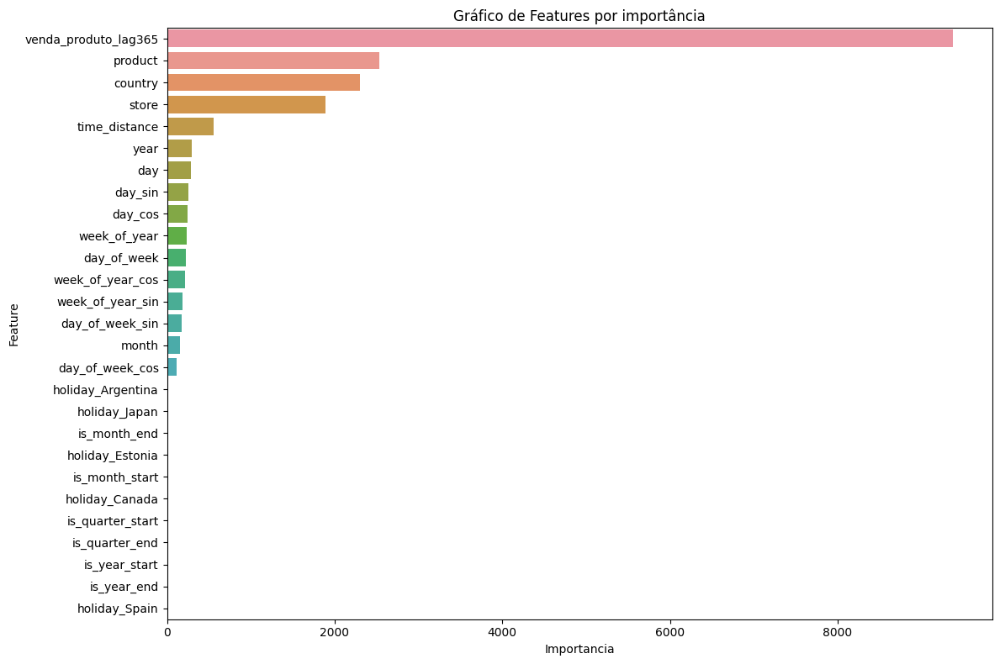

In [ ]:
df_importance = pd.DataFrame()
df_importance["Feature"] = x_train.columns
df_importance["Importancia"] = model.feature_importances_
fig = plt.figure(figsize=(12,8))
sns.barplot(x="Importancia", y="Feature", data = df_importance.sort_values(by="Importancia", ascending=False))
plt.title('Gráfico de Features por importância')
plt.tight_layout()
plt.show()

After running the model with all features, a new model was run based on the most important features as shown in the analysis above.

# Submission

In [ ]:
dfsubmission['num_sold'] = y_test
dfsubmission['num_sold']=dfsubmission['num_sold'].astype(int)

In [ ]:
dfsubmission['num_sold']

0         46
1         46
2          5
3         45
4         33
        ... 
27370    820
27371    869
27372    129
27373    707
27374    636
Name: num_sold, Length: 27375, dtype: int64

In [ ]:
#This was a function recommended by the Kaggle community who diagnosed that there was a scaling issue in the test data.
def multipliers(predictors, prediction, canada = 1, japan = 1, spain = 1, estonia = 1, argentina = 1):
    prediction[predictors.country == 'Canada'] *= canada
    prediction[predictors.country == 'Japan'] *= japan
    prediction[predictors.country == 'Spain'] *= spain
    prediction[predictors.country == 'Estonia'] *= estonia
    prediction[predictors.country == 'Argentina'] *= argentina
    return prediction

In [ ]:
dfsubmission['num_sold']= np.round(multipliers(x_test, dfsubmission["num_sold"] * 1.5, .58, .77, 1.01, 1.08, 2.81))

In [ ]:
dfsubmission.to_csv('submission_v19.csv', index=False)

#Outcome


In the final result of the competition, a performance score of 8.31% was achieved in the SMAPE metric

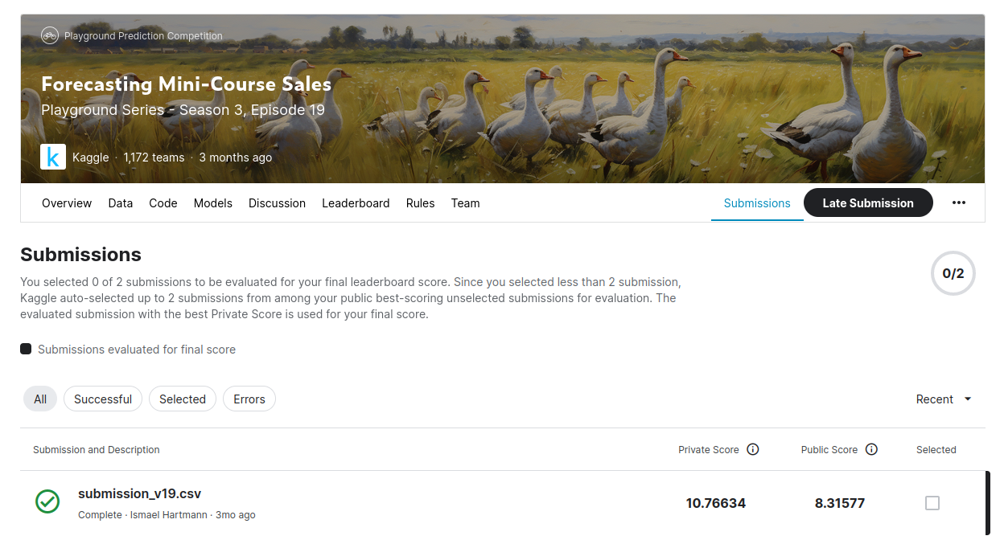